In [ ]:
import numpy as np
import pandas as pd

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import mean_absolute_error, mean_squared_error
from sklearn.neighbors import KNeighborsRegressor
from sklearn.inspection import permutation_importance
import tensorflow as tf
from tensorflow import keras

In [ ]:
from google.colab import files
files.upload()

Saving dataset.csv to dataset (1).csv


{'dataset (1).csv': b',track_id,artists,album_name,track_name,popularity,duration_ms,explicit,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,track_genre\n0,5SuOikwiRyPMVoIQDJUgSV,Gen Hoshino,Comedy,Comedy,73,230666,False,0.676,0.461,1,-6.746,0,0.143,0.0322,1.01e-06,0.358,0.715,87.917,4,acoustic\n1,4qPNDBW1i3p13qLCt0Ki3A,Ben Woodward,Ghost (Acoustic),Ghost - Acoustic,55,149610,False,0.42,0.166,1,-17.235,1,0.0763,0.924,5.56e-06,0.101,0.267,77.489,4,acoustic\n2,1iJBSr7s7jYXzM8EGcbK5b,Ingrid Michaelson;ZAYN,To Begin Again,To Begin Again,57,210826,False,0.438,0.359,0,-9.734,1,0.0557,0.21,0.0,0.117,0.12,76.332,4,acoustic\n3,6lfxq3CG4xtTiEg7opyCyx,Kina Grannis,Crazy Rich Asians (Original Motion Picture Soundtrack),Can\'t Help Falling In Love,71,201933,False,0.266,0.0596,0,-18.515,1,0.0363,0.905,7.07e-05,0.132,0.143,181.74,3,acoustic\n4,5vjLSffimiIP26QG5WcN2K,Chord Overstreet,Hold On,Hold On,82,198853,False,0.618,0.443,2,-9

In [92]:
data = pd.read_csv('dataset.csv')
data

,Unnamed: 0,track_id,artists,album_name,track_name,popularity,duration_ms,explicit,danceability,energy,...,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,track_genre
0,0,5SuOikwiRyPMVoIQDJUgSV,Gen Hoshino,Comedy,Comedy,73,230666,False,0.676,0.4610,...,-6.746,0,0.1430,0.0322,0.000001,0.3580,0.7150,87.917,4,acoustic
1,1,4qPNDBW1i3p13qLCt0Ki3A,Ben Woodward,Ghost (Acoustic),Ghost - Acoustic,55,149610,False,0.420,0.1660,...,-17.235,1,0.0763,0.9240,0.000006,0.1010,0.2670,77.489,4,acoustic
2,2,1iJBSr7s7jYXzM8EGcbK5b,Ingrid Michaelson;ZAYN,To Begin Again,To Begin Again,57,210826,False,0.438,0.3590,...,-9.734,1,0.0557,0.2100,0.000000,0.1170,0.1200,76.332,4,acoustic
3,3,6lfxq3CG4xtTiEg7opyCyx,Kina Grannis,Crazy Rich Asians (Original Motion Picture Sou...,Can't Help Falling In Love,71,201933,False,0.266,0.0596,...,-18.515,1,0.0363,0.9050,0.000071,0.1320,0.1430,181.740,3,acoustic
4,4,5vjLSffimiIP26QG5WcN2K,Chord Overstreet,Hold On,Hold On,82,198853,False,0.618,0.4430,...,-9.681,1,0.0526,0.4690,0.000000,0.0829,0.1670,119.949,4,acoustic
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
113995,113995,2C3TZjDRiAzdyViavDJ217,Rainy Lullaby,#mindfulness - Soft Rain for Mindful Meditatio...,Sleep My Little Boy,21,384999,False,0.172,0.2350,...,-16.393,1,0.0422,0.6400,0.928000,0.0863,0.0339,125.995,5,world-music
113996,113996,1hIz5L4IB9hN3WRYPOCGPw,Rainy Lullaby,#mindfulness - Soft Rain for Mindful Meditatio...,Water Into Light,22,385000,False,0.174,0.1170,...,-18.318,0,0.0401,0.9940,0.976000,0.1050,0.0350,85.239,4,world-music
113997,113997,6x8ZfSoqDjuNa5SVP5QjvX,Cesária Evora,Best Of,Miss Perfumado,22,271466,False,0.629,0.3290,...,-10.895,0,0.0420,0.8670,0.000000,0.0839,0.7430,132.378,4,world-music
113998,113998,2e6sXL2bYv4bSz6VTdnfLs,Michael W. Smith,Change Your World,Friends,41,283893,False,0.587,0.5060,...,-10.889,1,0.0297,0.3810,0.000000,0.2700,0.4130,135.960,4,world-music


In [93]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 114000 entries, 0 to 113999
Data columns (total 21 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   Unnamed: 0        114000 non-null  int64  
 1   track_id          114000 non-null  object 
 2   artists           113999 non-null  object 
 3   album_name        113999 non-null  object 
 4   track_name        113999 non-null  object 
 5   popularity        114000 non-null  int64  
 6   duration_ms       114000 non-null  int64  
 7   explicit          114000 non-null  bool   
 8   danceability      114000 non-null  float64
 9   energy            114000 non-null  float64
 10  key               114000 non-null  int64  
 11  loudness          114000 non-null  float64
 12  mode              114000 non-null  int64  
 13  speechiness       114000 non-null  float64
 14  acousticness      114000 non-null  float64
 15  instrumentalness  114000 non-null  float64
 16  liveness          11

**Значение столбцов:**

track_id: уникальный идентификатор трека.

artists: исполнители трека.

album_name: название альбома, к которому принадлежит трек.

track_name: название трека.

popularity: показатель популярности трека.

duration_ms: длительность трека в миллисекундах.

explicit: булево значение, показывающее, содержит ли трек ненормативную лексику.

danceability: танцевальность трека.

energy: энергия трека.

key: ключ трека (тональность).

loudness: громкость трека.

mode: режим трека (мажор/минор).

speechiness: речевость трека.

acousticness: акустика трека.

instrumentalness: инструментальность трека.

liveness: живость трека.

valence: валентность трека (эмоциональный окрас).

tempo: темп трека.

time_signature: метрическая подпись трека.

track_genre: жанр трека.

In [ ]:
data['popularity'].value_counts()

,count
popularity,
0,16020
22,2354
21,2344
44,2288
1,2140
...,...
96,7
94,7
95,5


**Количество пустых значений и их удаление:**

In [ ]:
data.isnull().sum()

,0
Unnamed: 0,0
track_id,0
artists,0
album_name,0
track_name,0
popularity,0
duration_ms,0
explicit,0
danceability,0
energy,0


In [ ]:
data = data.dropna()

# Анализ данных

### **График №1** - Рапределение популярности песен, количество треков с разной популярностью

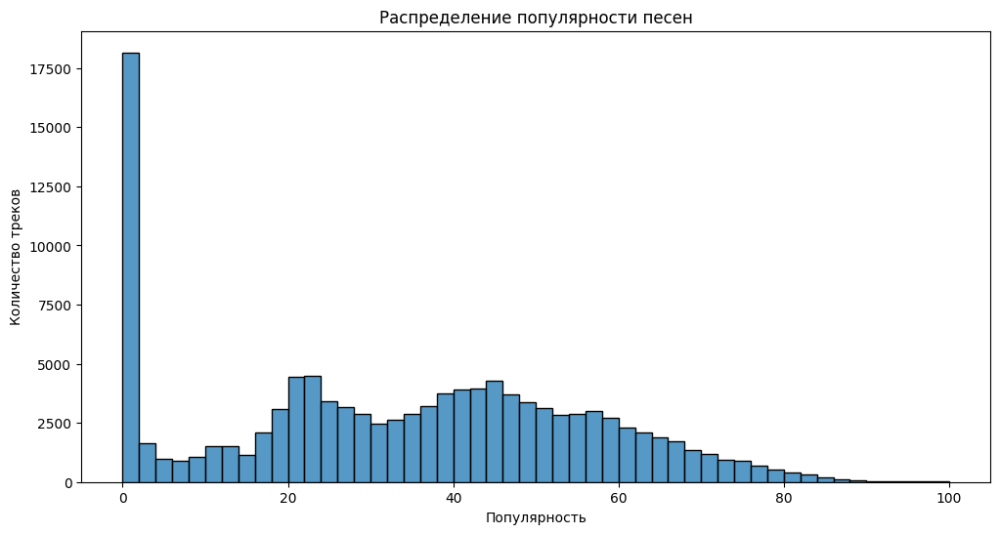

In [ ]:
plt.figure(figsize=(12, 6))
sns.histplot(data=df, x='popularity', bins=50)
plt.xlabel('Популярность')
plt.ylabel('Количество треков')
plt.title('Распределение популярности песен')
plt.show()

Исходя из графика можно заметить, что присутсвует много треков с нулевой популярностью, а также с показателем популярности 20 и ~40

### **График №2** - Частота использования различных тональностей в треках

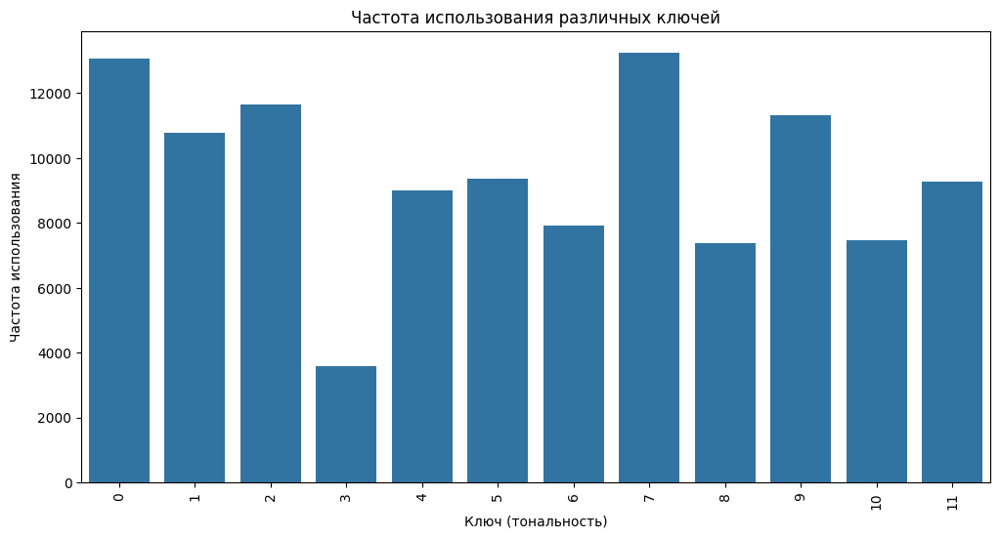

In [ ]:
plt.figure(figsize=(12, 6))
sns.countplot(x='key', data=df)
plt.xlabel('Ключ (тональность)')
plt.ylabel('Частота использования')
plt.title('Частота использования различных ключей')
plt.xticks(rotation=90)
plt.show()

Заметим, что больше всего треков, написаных в 0 и 7 тональностях. Это можно обусловить тем, что большинство популярных мотивов и мелодий похожи друг на друга, исходя из этого они пишутся в одних тональностях

### **График №3** - Зависимость популярности трека от его длительности

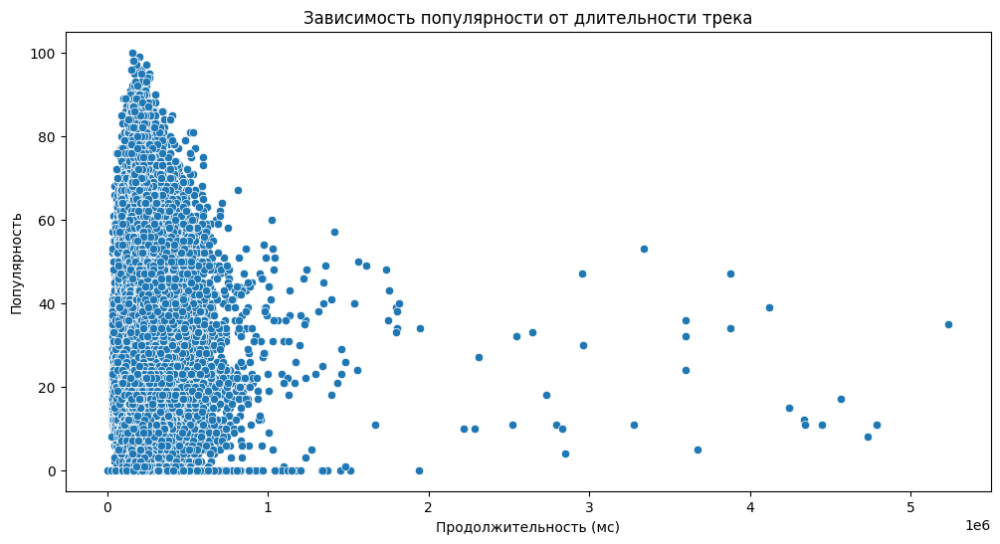

In [ ]:
plt.figure(figsize=(12, 6))
sns.scatterplot(x='duration_ms', y='popularity', data=df)
plt.xlabel('Продолжительность (мс)')
plt.ylabel('Популярность')
plt.title('Зависимость популярности от длительности трека')
plt.show()

На графике видно, что короткие треки пользуются большей популярностью, чем более длинные. Скорее всего это вызвано стремлением к быстрому потреблению информации у современных людей, точно также, как и с короткими видео

### **Графики №4-5** - Зависимость популярности песен от ненормативной лексики и их количество

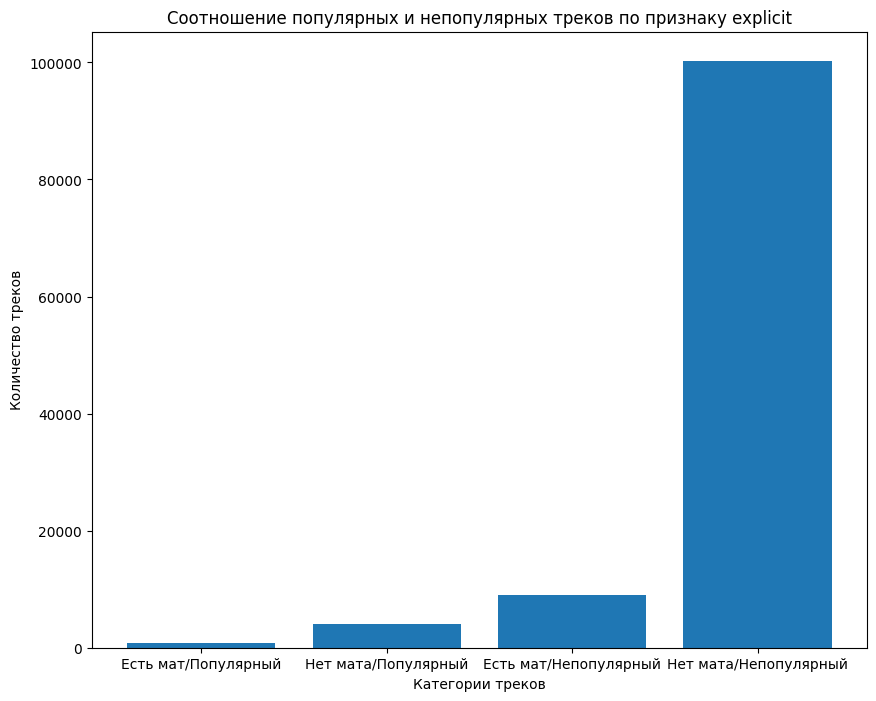

In [ ]:
explicit_popular = df.query("explicit == True & popularity > 70")
non_explicit_popular = df.query("explicit == False & popularity > 70")
explicit_nonpopular = df.query("explicit == True & popularity <= 70")
non_explicit_nonpopular = df.query("explicit == False & popularity <= 70")

labels = ['Есть мат/Популярный', 'Нет мата/Популярный', 'Есть мат/Непопулярный', 'Нет мата/Непопулярный']
values = [
    len(explicit_popular),
    len(non_explicit_popular),
    len(explicit_nonpopular),
    len(non_explicit_nonpopular)
]

plt.figure(figsize=(10, 8))
plt.bar(labels, values)
plt.title('Соотношение популярных и непопулярных треков по признаку explicit')
plt.xlabel('Категории треков')
plt.ylabel('Количество треков')
plt.show()

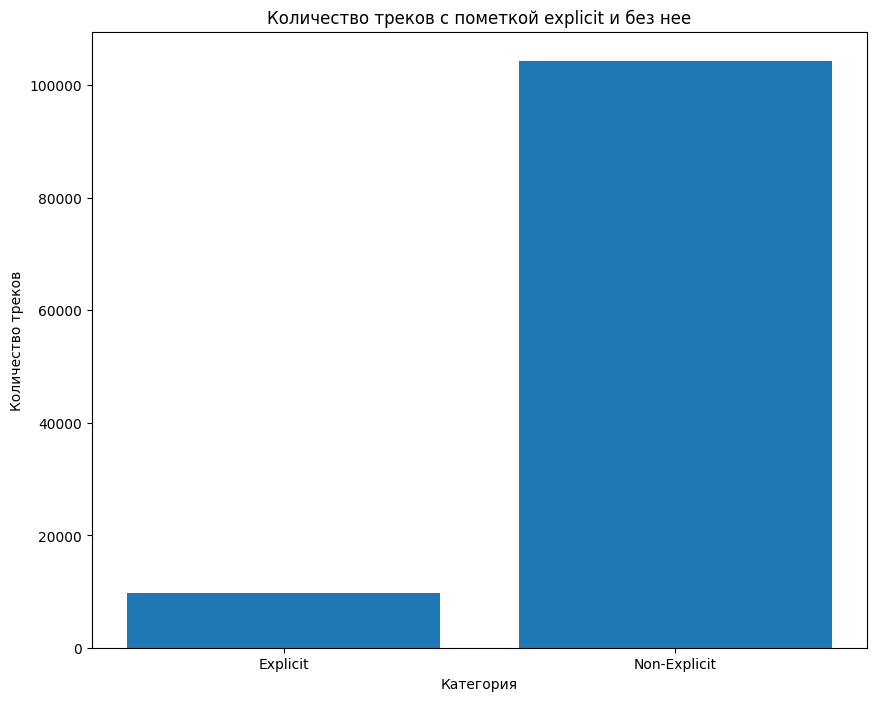

In [ ]:
explicit_count = df['explicit'].sum()
non_explicit_count = len(df) - explicit_count

labels = ['Explicit', 'Non-Explicit']
values = [explicit_count, non_explicit_count]


plt.figure(figsize=(10, 8))
plt.bar(labels, values)
plt.title('Количество треков с пометкой explicit и без нее')
plt.xlabel('Категория')
plt.ylabel('Количество треков')

plt.show()

Будем считать трек популярным, если его показатель выше 70. Если сравнивать популярные треки, то число треков с цензурой больше, скорее всего это вызвано тем, что данные произведения можно включать в общественных местах, а также слушать при детях. С непопулярными треками точно так же. Важно учитывать то, что число треков с нецензурной лексикой гораздо меньше

###**График №6** - Зависимость популярности трека от его темпа

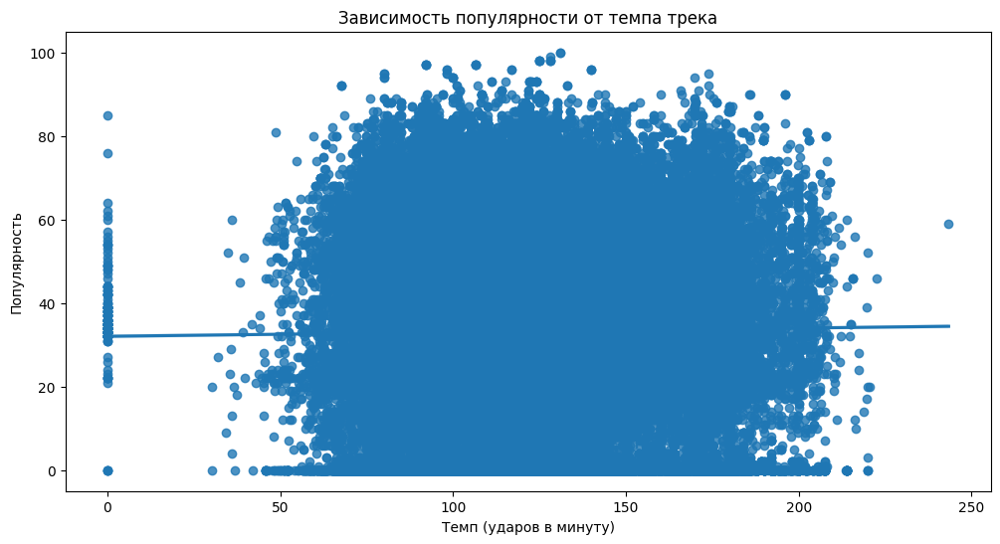

In [ ]:
plt.figure(figsize=(12, 6))
sns.regplot(x='tempo', y='popularity', data=df)
plt.xlabel('Темп (ударов в минуту)')
plt.ylabel('Популярность')
plt.title('Зависимость популярности от темпа трека')
plt.show()

Заметим, что большинство популярных треков имеют средний темп, однако есть популярные треки и в медленном темпе. Однако хочется заметить, что большинство треков написаны в среднем темпе, поэтому тепм как фактор мало влияет на популряность

### **График №7** - Зависимость популярнсти трека от его громкости

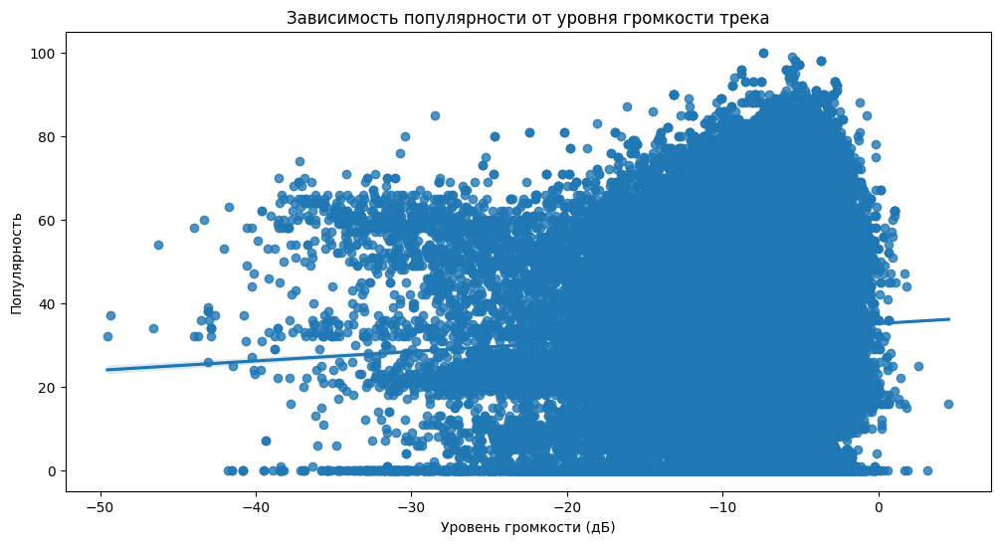

In [ ]:
plt.figure(figsize=(12, 6))
sns.regplot(x='loudness', y='popularity', data=df)
plt.xlabel('Уровень громкости (дБ)')
plt.ylabel('Популярность')
plt.title('Зависимость популярности от уровня громкости трека')
plt.show()

Самые популярные треки имеют громкость близкую к 0 дБ, скорее всего потому что это привычная громкость для человека.

### **График №8** - Количество популярных треков в разных жанрах

<ipython-input-33-31c21d3aa2cf>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['is_popular'] = data['popularity'].apply(lambda x: 'Популярный' if x >= threshold_popularity else 'Непопулярный')


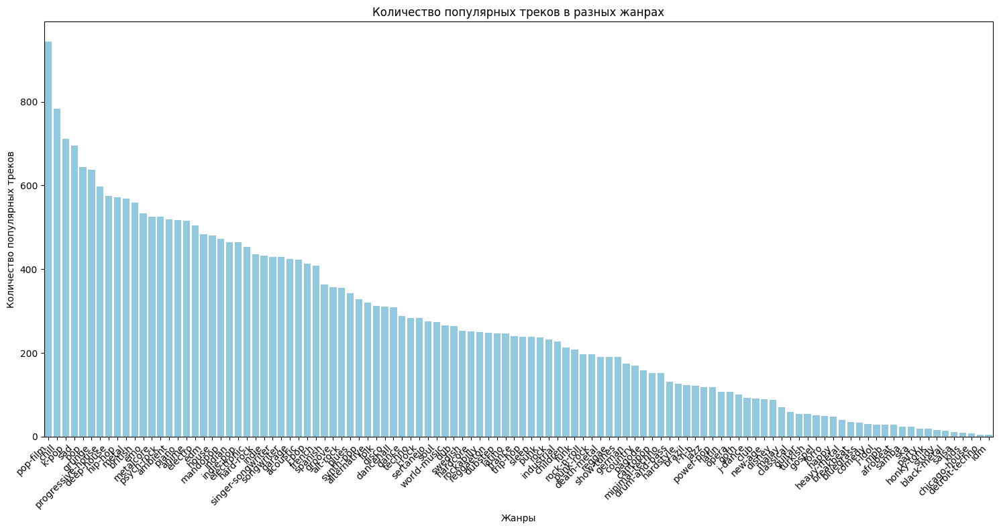

In [ ]:
# Установим порог популярности
threshold_popularity = 50

# Добавляем новый столбец для обозначения популярных треков
data['is_popular'] = data['popularity'].apply(lambda x: 'Популярный' if x >= threshold_popularity else 'Непопулярный')

# Считаем количество популярных треков по жанрам
genre_counts = data[data['is_popular'] == 'Популярный']['track_genre'].value_counts()

# Строим график
plt.figure(figsize=(15, 8))  # Увеличенный размер фигуры
sns.barplot(x=genre_counts.index, y=genre_counts.values, color='skyblue')
plt.xlabel('Жанры')
plt.ylabel('Количество популярных треков')
plt.title('Количество популярных треков в разных жанрах')
plt.xticks(rotation=45, ha='right')  # Поворот меток и выравнивание вправо
plt.tight_layout()  # Автоматическое управление пространством вокруг осей
plt.show()

Больше всего популярных треков в категории pop-film, это было очевидно, ведь напрвление поп в жанре музыки уже давно занимает лидирующие позиции

## Корреляционная матрица до добавления новых признаков

Перевод категориальных данных в числовые

In [133]:
from sklearn.preprocessing import LabelEncoder

categorical_cols = data.select_dtypes(include=['object']).columns
label_encoders = {}
categorical_cols

for col in categorical_cols:
    le = LabelEncoder()
    data[col] = le.fit_transform(data[col])
    label_encoders[col] = le

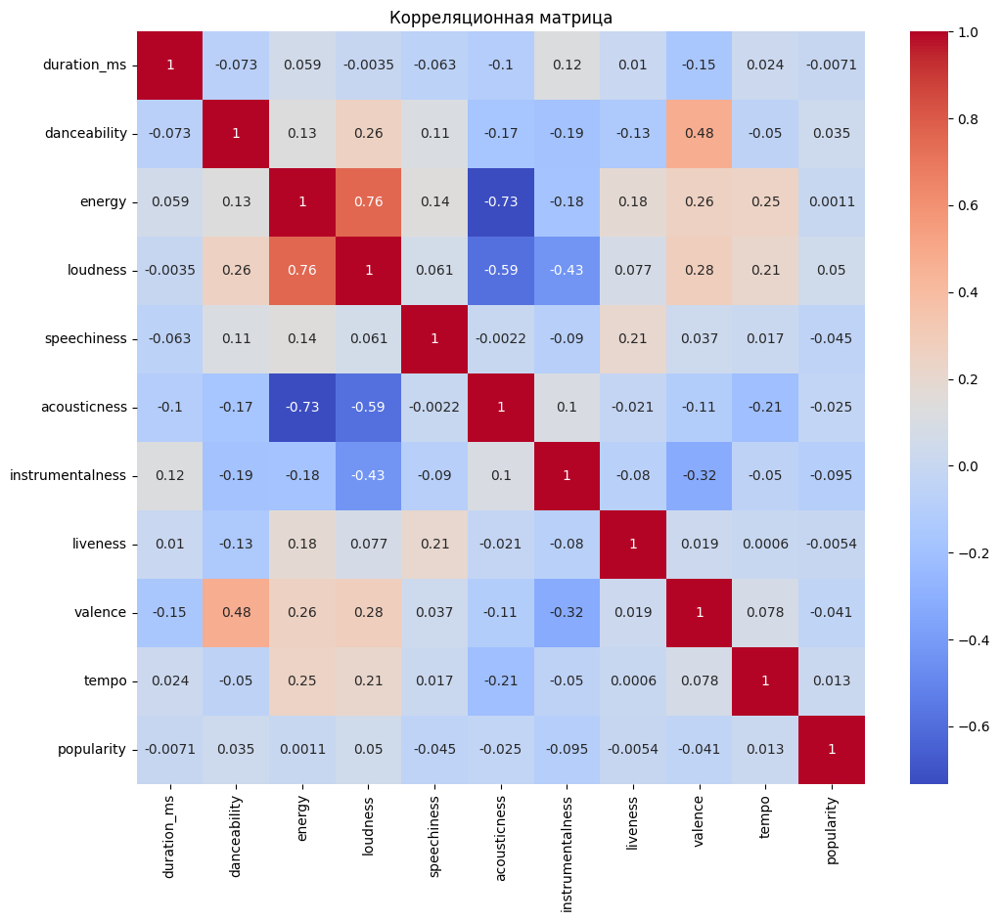

In [101]:
numerical_features = [
    'duration_ms', 'danceability', 'energy', 'loudness', 'speechiness',
    'acousticness', 'instrumentalness', 'liveness', 'valence', 'tempo'
]

correlation_matrix = data[numerical_features + ['popularity']].corr()
plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=True, cmap="coolwarm")
plt.title('Корреляционная матрица')
plt.show()

## Добавление новых признаков

In [108]:
# Отношение длительности трека к его темпу
data['duration_to_tempo_ratio'] = data['duration_ms'] / data['tempo']

In [109]:
# Индикатор принадлежности к мажору или минору
data['is_major'] = (data['mode'] == 1).astype(int)

In [157]:
data

,Unnamed: 0,track_id,artists,album_name,track_name,popularity,duration_ms,explicit,danceability,energy,...,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,track_genre,duration_to_tempo_ratio,is_major
0,0,62846,10357,8100,11741,73,230666,False,0.676,0.4610,...,0.1430,0.0322,0.000001,0.3580,0.7150,87.917,4,0,2623.679152,0
1,1,55668,3287,14796,22528,55,149610,False,0.420,0.1660,...,0.0763,0.9240,0.000006,0.1010,0.2670,77.489,4,0,1930.725651,1
2,2,19766,12397,39162,60774,57,210826,False,0.438,0.3590,...,0.0557,0.2100,0.000000,0.1170,0.1200,76.332,4,0,2761.960908,1
3,3,77942,14839,8580,9580,71,201933,False,0.266,0.0596,...,0.0363,0.9050,0.000071,0.1320,0.1430,181.740,3,0,1111.109277,1
4,4,68242,5255,16899,25689,82,198853,False,0.618,0.4430,...,0.0526,0.4690,0.000000,0.0829,0.1670,119.949,4,0,1657.812904,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
113995,113995,25199,22486,66,53329,21,384999,False,0.172,0.2350,...,0.0422,0.6400,0.928000,0.0863,0.0339,125.995,5,113,3055.668876,1
113996,113996,19583,22486,66,65090,22,385000,False,0.174,0.1170,...,0.0401,0.9940,0.976000,0.1050,0.0350,85.239,4,113,4516.711834,0
113997,113997,80127,4952,5028,38207,22,271466,False,0.629,0.3290,...,0.0420,0.8670,0.000000,0.0839,0.7430,132.378,4,113,2050.688181,0
113998,113998,30456,18534,7238,21507,41,283893,False,0.587,0.5060,...,0.0297,0.3810,0.000000,0.2700,0.4130,135.960,4,113,2088.062665,1


In [114]:
new_features = ['duration_to_tempo_ratio', 'is_major']

new_correlations = data[new_features + ['popularity']].corr()['popularity']
print(new_correlations)

duration_to_tempo_ratio   -0.014151
is_major                  -0.013931
popularity                 1.000000
Name: popularity, dtype: float64


Новая корреляционная матрица

Видны улучшения

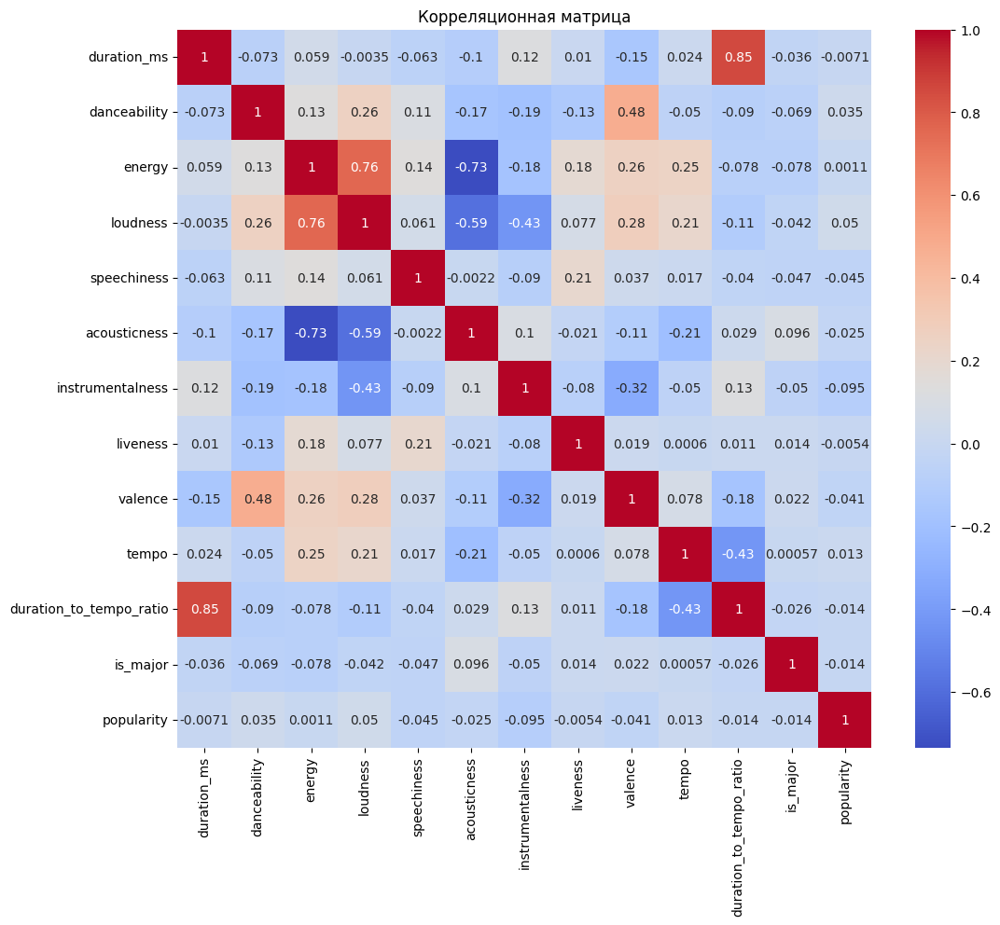

In [115]:
numerical_features = [
    'duration_ms', 'danceability', 'energy', 'loudness', 'speechiness',
    'acousticness', 'instrumentalness', 'liveness', 'valence', 'tempo', 'duration_to_tempo_ratio', 'is_major'
]

correlation_matrix = data[numerical_features + ['popularity']].corr()
plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=True, cmap="coolwarm")
plt.title('Корреляционная матрица')
plt.show()

In [160]:
# Разделение данных на обучающую и тестовую выборки
X = data.drop(columns=['popularity', 'explicit'])  # измените на ваш целевой признак, если необходимо
y = data['popularity']  # измените на ваш целевой признак, если необходимо
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

Feature Importances

Оценим важность признаков с помощью модели Random Forest:

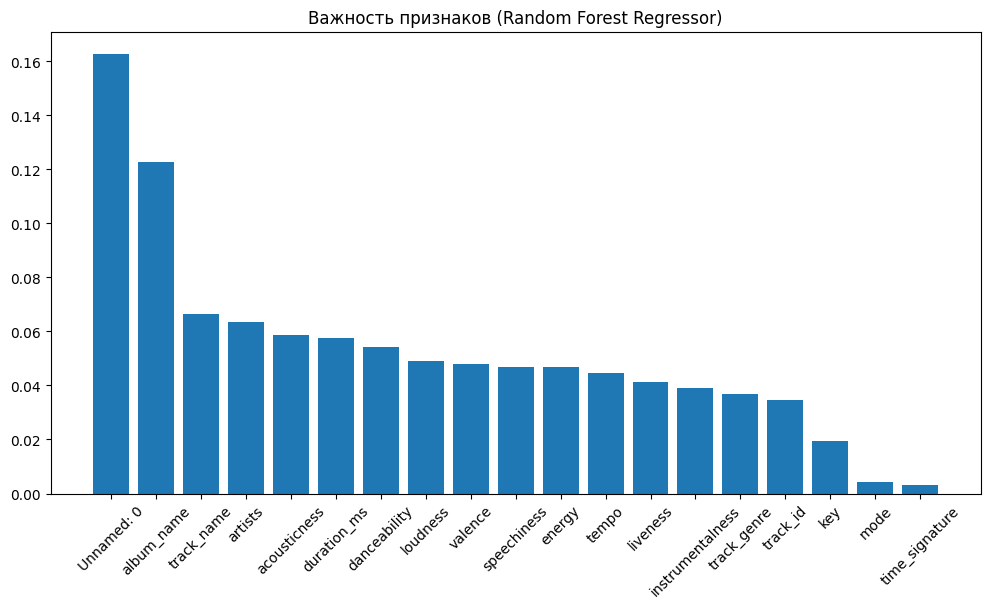

In [175]:
from sklearn.ensemble import RandomForestRegressor

model = RandomForestRegressor(n_estimators=100, random_state=42)
model.fit(X, y)

feature_importances = model.feature_importances_
sorted_indices = np.argsort(feature_importances)[::-1]

plt.figure(figsize=(12, 6))
plt.bar(range(X.shape[1]), feature_importances[sorted_indices])
plt.xticks(range(X.shape[1]), X.columns[sorted_indices], rotation=45)
plt.title('Важность признаков (Random Forest Regressor)')
plt.show()

Название альбома и трека, а также исполнитель больше всего влияют на популярность трека

In [161]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

# Build the model
model = keras.Sequential([
    keras.layers.Dense(64, activation='relu', input_shape=(X_train.shape[1],)),
    keras.layers.Dense(64, activation='relu'),
    keras.layers.Dense(1)
])

# Compile the model
model.compile(optimizer='adam', loss='mean_squared_error')

# Train the model
model.fit(X_train, y_train, epochs=10, batch_size=32, validation_split=0.2)

# Evaluate the model
loss = model.evaluate(X_test, y_test)
print(f'Test Loss: {loss}')

Epoch 1/10


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


2280/2280 ━━━━━━━━━━━━━━━━━━━━ 6s 2ms/step - loss: 635.3459 - val_loss: 477.9737
Epoch 2/10
2280/2280 ━━━━━━━━━━━━━━━━━━━━ 5s 2ms/step - loss: 476.3716 - val_loss: 473.5252
Epoch 3/10
2280/2280 ━━━━━━━━━━━━━━━━━━━━ 4s 2ms/step - loss: 464.0954 - val_loss: 458.4261
Epoch 4/10
2280/2280 ━━━━━━━━━━━━━━━━━━━━ 6s 2ms/step - loss: 451.8723 - val_loss: 454.1856
Epoch 5/10
2280/2280 ━━━━━━━━━━━━━━━━━━━━ 5s 2ms/step - loss: 447.8328 - val_loss: 451.6230
Epoch 6/10
2280/2280 ━━━━━━━━━━━━━━━━━━━━ 5s 2ms/step - loss: 439.6602 - val_loss: 447.2549
Epoch 7/10
2280/2280 ━━━━━━━━━━━━━━━━━━━━ 5s 2ms/step - loss: 440.2268 - val_loss: 443.5996
Epoch 8/10
2280/2280 ━━━━━━━━━━━━━━━━━━━━ 4s 2ms/step - loss: 435.8540 - val_loss: 442.2222
Epoch 9/10
2280/2280 ━━━━━━━━━━━━━━━━━━━━ 4s 2ms/step - loss: 433.8722 - val_loss: 444.6183
Epoch 10/10
2280/2280 ━━━━━━━━━━━━━━━━━━━━ 5s 2ms/step - loss: 430.6901 - val_loss: 436.9802
713/713 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 439.8569
Test Loss: 434.1988220214844


In [147]:
X_train

,Unnamed: 0,track_id,artists,album_name,track_name,duration_ms,danceability,energy,key,loudness,...,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,track_genre,duration_to_tempo_ratio,is_major
84744,84744,77679,10941,8164,29671,293960,0.640,0.59300,9,-10.663,...,0.0396,0.3960,0.024700,0.0599,0.5280,97.404,4,84,3017.945875,0
89295,89295,67727,13239,13332,10928,147133,0.835,0.71800,7,-5.620,...,0.0694,0.2260,0.000002,0.1080,0.4270,92.028,4,89,1598.785152,0
66688,66688,14965,2823,12137,24711,98386,0.786,0.22500,9,-16.516,...,0.5730,0.6790,0.000000,0.2010,0.6580,110.066,4,66,893.881853,1
51391,51391,70383,25091,24636,38624,232173,0.709,0.82900,0,-5.817,...,0.2450,0.0698,0.000000,0.5610,0.6540,137.954,4,51,1682.974035,1
95123,95123,27947,23554,28012,17324,360320,0.786,0.70200,0,-6.742,...,0.0456,0.5110,0.000000,0.1200,0.6960,104.030,4,95,3463.616265,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
76820,76820,78157,1416,4462,32174,162613,0.554,0.00763,4,-30.566,...,0.0502,0.9150,0.000970,0.2210,0.1560,119.502,4,76,1360.755469,1
110268,110268,6112,24008,39094,60644,240062,0.689,0.55400,9,-8.200,...,0.0759,0.0910,0.914000,0.0867,0.1630,148.002,4,110,1622.018621,1
103694,103694,81800,9821,23957,27174,136306,0.629,0.56000,0,-11.455,...,0.0523,0.5950,0.000000,0.1820,0.8800,118.895,3,103,1146.440136,0
860,860,28813,27396,17753,27380,216841,0.421,0.10700,6,-15.191,...,0.0335,0.9480,0.000000,0.0881,0.1180,104.218,4,0,2080.648257,1


### Модели машинного обучения

Построим различные модели и выберем лучшую:

In [166]:
# Линейная регрессия:
from sklearn.linear_model import LinearRegression

lr_model = LinearRegression()
lr_model.fit(X_train, y_train)

y_pred_lr = lr_model.predict(X_test)
mae_lr = mean_absolute_error(y_test, y_pred_lr)
mse_lr = mean_squared_error(y_test, y_pred_lr)
print(f'MAE для линейной регрессии: {mae_lr}')
print(f'MSE для линейной регрессии: {mse_lr}')

MAE для линейной регрессии: 18.27837535273989
MSE для линейной регрессии: 480.7392269611318


In [167]:
# Деревья решений:

tree_model = DecisionTreeRegressor(random_state=42)
tree_model.fit(X_train, y_train)

y_pred_tree = tree_model.predict(X_test)
mae_tree = mean_absolute_error(y_test, y_pred_tree)
mse_tree = mean_squared_error(y_test, y_pred_tree)
print(f'MAE для деревьев решений: {mae_tree}')
print(f'MSE для деревьев решений: {mse_tree}')

MAE для деревьев решений: 12.17048245614035
MSE для деревьев решений: 420.82662280701754


In [170]:
# Gradient Boosting:
from sklearn.ensemble import GradientBoostingRegressor

gb_model = GradientBoostingRegressor(random_state=42)
gb_model.fit(X_train, y_train)

y_pred_gb = gb_model.predict(X_test)
mae_gb = mean_absolute_error(y_test, y_pred_gb)
mse_gb = mean_squared_error(y_test, y_pred_gb)
print(f'MAE для Gradient Boosting: {mae_gb}')
print(f'MSE для Gradient Boosting: {mse_gb}')

MAE для Gradient Boosting: 15.698340951827673
MSE для Gradient Boosting: 377.787982953551


In [172]:
# Нейронная сеть:
from sklearn.neural_network import MLPRegressor

nn_model = MLPRegressor(hidden_layer_sizes=(100,), activation='relu', solver='adam', random_state=42)
nn_model.fit(X_train, y_train)

y_pred_nn = nn_model.predict(X_test)
mae_nn = mean_absolute_error(y_test, y_pred_nn)
mse_nn = mean_squared_error(y_test, y_pred_nn)
print(f'MSE для нейронной сети: {mae_nn}')
print(f'MSE для нейронной сети: {mse_nn}')

MSE для нейронной сети: 16.17320285937474
MSE для нейронной сети: 405.4519582742397


/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


По итогам лучшей моделью стала gb_model, так как ее значения MAE/MSE в совокупности ниже, чем у других, а это означает, что данная модель более точная и лучше справляется с задачей

In [174]:
from sklearn.model_selection import KFold, cross_validate
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.metrics import make_scorer, mean_absolute_error, mean_squared_error

# Определение функции для вычисления MAE и MSE
mae_scorer = make_scorer(mean_absolute_error)
mse_scorer = make_scorer(mean_squared_error)

# Создание модели Gradient Boosting
gb_model = GradientBoostingRegressor(random_state=42)

# Определение количества фолдов для кросс-валидации
n_folds = 5

# Настройка кросс-валидации
kf = KFold(n_splits=n_folds, shuffle=True, random_state=42)

# Выполнение кросс-валидации
scoring = {'mae': mae_scorer, 'mse': mse_scorer}
results = cross_validate(gb_model, X_train, y_train, cv=kf, scoring=scoring, return_train_score=False)

# Вывод результатов
print(f"Mean MAE: {results['test_mae'].mean():.4f}, Std MAE: {results['test_mae'].std():.4f}")
print(f"Mean MSE: {results['test_mse'].mean():.4f}, Std MSE: {results['test_mse'].std():.4f}")

Mean MAE: 15.8105, Std MAE: 0.0940
Mean MSE: 383.8372, Std MSE: 3.7723


# Заключение

На основании проведенного анализа данных и экспериментов с различными моделями машинного обучения, было установлено, что модель GradientBoostingRegressor продемонстрировала наилучшие результаты по точности предсказания целевой переменной. Этот результат свидетельствует об эффективности применения ансамблевых методов для решения задач регрессии в контексте музыкальных данных.

Важную роль в предсказании популярности треков играют такие признаки, как название альбома, название трека и исполнитель. Эти характеристики оказались ключевыми факторами, влияющими на успех музыкального произведения, что подтверждает значимость качественного контента и узнаваемости артиста в музыкальной индустрии.